In [88]:
import numpy as np
import matplotlib.pyplot as plt
import random
import pandas as pd
from scipy.ndimage import maximum_filter, minimum_filter
from scipy.stats import skew
from scipy.signal import find_peaks


import sliding_distance as sd
from objects import *
from render import render

%matplotlib widget
stair_width = 200
stair_length = 50
stair_height = 50
diff_ratio = 1e-4

In [5]:
def find_local_maxima_values(array):

    # Create a maximum filter
    neighborhood_size = 3  # Size of the region to compare (3x3 for 2D local maxima)
    filtered = maximum_filter(array, size=neighborhood_size, mode='constant', cval=-np.inf)

    # Local maxima: Compare the original array with the filtered version
    local_maxima_mask = (array == filtered)

    # Extract the values of local maxima
    local_maxima_values = array[local_maxima_mask]

    return local_maxima_values.mean()

def find_local_minima_values(array):
    # Create a minimum filter
    neighborhood_size = 3  # Size of the region to compare (3x3 for 2D local minima)
    filtered = minimum_filter(array, size=neighborhood_size, mode='constant', cval=np.inf)

    # Local minima: Compare the original array with the filtered version
    local_minima_mask = (array == filtered)

    # Extract the values of local minima
    local_minima_values = array[local_minima_mask]

    return local_minima_values.mean()

def laplacian(u, dx, dy):
    laplacian = np.zeros_like(u)
    laplacian[1:-1, 1:-1] = (
        (u[2:, 1:-1] - 2 * u[1:-1, 1:-1] + u[:-2, 1:-1]) / dx**2 +
        (u[1:-1, 2:] - 2 * u[1:-1, 1:-1] + u[1:-1, :-2]) / dy**2
    )
    return laplacian


# Features Extraction Function

In [111]:
def cut_stairs(u):
    return u[:, stair_length:stair_length*2]

def get_inner_edge_avg(u):
    return u[:,2*stair_length-2].mean()

def roughness(u):
    return laplacian(u[:,stair_length:stair_length*2],1,1).std()

def get_avg_side_func(u):
    avg = np.zeros(shape=(stair_length))

    for line in u:
        avg += line[stair_length:stair_length*2]

    return avg / avg.max()


def get_avg_front_func(u):
    avg = np.zeros(shape=(stair_width))

    for i in range(stair_length):
        avg += u[:,stair_length+i]

    return avg / avg.max()

    # return u[:,stair_length]

def correlation_coefficient(x, y, sigma_y):
    # Convert inputs to NumPy arrays for element-wise operations
    x = np.array(x)
    y = np.array(y)
    sigma_y = np.array(sigma_y)
    
    # Calculate the mean of x and y
    mean_x = np.mean(x)
    mean_y = np.average(y, weights=1/sigma_y**2)  # Weighted average for y
    
    # Compute the numerator and denominator of the formula
    numerator = np.sum((x - mean_x) * (y - mean_y) / sigma_y**2)
    denominator = np.sqrt(np.sum((x - mean_x)**2) * np.sum(((y - mean_y)**2 / sigma_y**2)))
    
    # Return the correlation coefficient
    return numerator / denominator

def peak_index(f):
    f = f-f.min()
    f = f/f.max()
    p, a = find_peaks(f,prominence=0.05)
    s, a = find_peaks(1-f,prominence=0.05)

    return len(p)+len(s)

# Inner Edge Test

prove that uncorrelated with age so that we can know H_initial and V_erode 

In [32]:
ages = [i for i in range(800,3000,100)]
xs = []
ys = []

data = pd.DataFrame({'x': xs, 'y': ys})
result = data.groupby('x')['y'].agg(['mean', 'std']).reset_index()

for i in ages:
    for j in range(2):
        stair_use = StairsUsage(20000, random.random(), random.randint(1,5))
        model = SimulationSettings(i, Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, sd.H_rubber_kPa, sd.sliding_distance, diff_ratio)), stairs_usage=stair_use, dt=i/2500)
        ys.append(get_inner_edge_avg(model.final_shape[0]))
        xs.append(i)

simulated 0/2500
simulated 1/2500
simulated 2/2500
simulated 3/2500
simulated 4/2500
simulated 5/2500
simulated 6/2500
simulated 7/2500
simulated 8/2500
simulated 9/2500
simulated 10/2500
simulated 11/2500
simulated 12/2500
simulated 13/2500
simulated 14/2500
simulated 15/2500
simulated 16/2500
simulated 17/2500
simulated 18/2500
simulated 19/2500
simulated 20/2500
simulated 21/2500
simulated 22/2500
simulated 23/2500
simulated 24/2500
simulated 25/2500
simulated 26/2500
simulated 27/2500
simulated 28/2500
simulated 29/2500
simulated 30/2500
simulated 31/2500
simulated 32/2500
simulated 33/2500
simulated 34/2500
simulated 35/2500
simulated 36/2500
simulated 37/2500
simulated 38/2500
simulated 39/2500
simulated 40/2500
simulated 41/2500
simulated 42/2500
simulated 43/2500
simulated 44/2500
simulated 45/2500
simulated 46/2500
simulated 47/2500
simulated 48/2500
simulated 49/2500
simulated 50/2500
simulated 51/2500
simulated 52/2500
simulated 53/2500
simulated 54/2500
simulated 55/2500
si

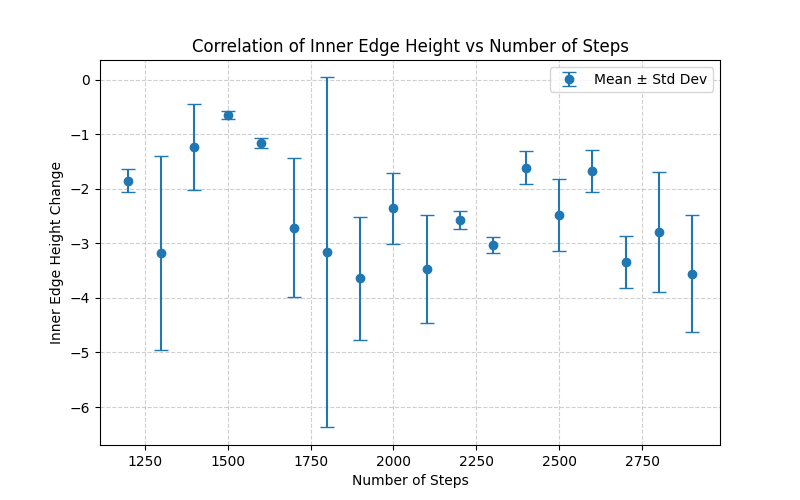

[[ 1.         -0.38201881]
 [-0.38201881  1.        ]]


In [36]:
data = pd.DataFrame({'x': xs, 'y': ys})

# Group by 'x' and calculate mean and standard deviation of 'y'
result = data.groupby('x')['y'].agg(['mean', 'std']).reset_index()

# Extract values for plotting
x_values = result['x']
y_means = result['mean'] - stair_height
y_stds = result['std']

# Plotting
plt.figure(figsize=(8, 5))
plt.errorbar(x_values[4:], y_means[4:], yerr=y_stds[4:], fmt='o', capsize=5, label='Mean ± Std Dev')
plt.title('Correlation of Inner Edge Height vs Number of Steps')
plt.xlabel('Number of Steps')
plt.ylabel('Inner Edge Height Change')
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend()
plt.show()

print(np.corrcoef(x_values[4:], y_means[4:]))


# Roughness
roughness is defined as standard deviation of the laplacian of the surface
has units of 1/cm

In [54]:
ages = [i for i in range(1000,3000,200)]
xs = []
ys = []

for i in ages:
    for j in range(5):
        stair_use = StairsUsage(random.randint(10000,50000), random.random(), random.randint(1,5))
        model = SimulationSettings(i, Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, sd.H_rubber_kPa, sd.sliding_distance*0.1, diff_ratio)), stairs_usage=stair_use, dt=int(i/1000))
        ys.append(roughness(model.final_shape[0]))
        xs.append(i)
        

simulated 0/1000
simulated 1/1000
simulated 2/1000
simulated 3/1000
simulated 4/1000
simulated 5/1000
simulated 6/1000
simulated 7/1000
simulated 8/1000
simulated 9/1000
simulated 10/1000
simulated 11/1000
simulated 12/1000
simulated 13/1000
simulated 14/1000
simulated 15/1000
simulated 16/1000
simulated 17/1000
simulated 18/1000
simulated 19/1000
simulated 20/1000
simulated 21/1000
simulated 22/1000
simulated 23/1000
simulated 24/1000
simulated 25/1000
simulated 26/1000
simulated 27/1000
simulated 28/1000
simulated 29/1000
simulated 30/1000
simulated 31/1000
simulated 32/1000
simulated 33/1000
simulated 34/1000
simulated 35/1000
simulated 36/1000
simulated 37/1000
simulated 38/1000
simulated 39/1000
simulated 40/1000
simulated 41/1000
simulated 42/1000
simulated 43/1000
simulated 44/1000
simulated 45/1000
simulated 46/1000
simulated 47/1000
simulated 48/1000
simulated 49/1000
simulated 50/1000
simulated 51/1000
simulated 52/1000
simulated 53/1000
simulated 54/1000
simulated 55/1000
si

[[1.         0.38781328]
 [0.38781328 1.        ]]


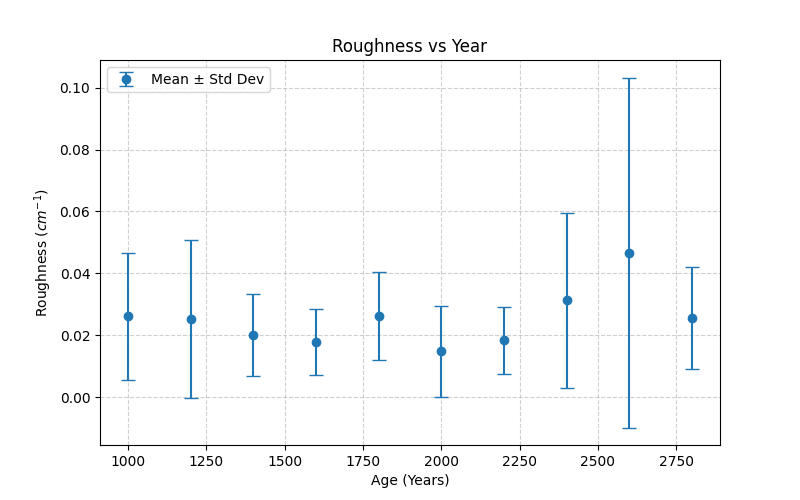

In [57]:
data = pd.DataFrame({'x': xs, 'y': ys})

# Group by 'x' and calculate mean and standard deviation of 'y'
result = data.groupby('x')['y'].agg(['mean', 'std']).reset_index()

# Extract values for plotting
x_values = result['x']
y_means = result['mean']
y_stds = result['std']

# Plotting
plt.figure(figsize=(8, 5))
plt.errorbar(x_values, y_means, yerr=y_stds, fmt='o', capsize=5, label='Mean ± Std Dev')
plt.title('Roughness vs Year')
plt.xlabel('Age (Years)')
plt.ylabel('Roughness ($cm^{-1}$)')
plt.grid(True, linestyle='--', alpha=0.6)
print(np.corrcoef(x_values, y_means))
plt.legend()
plt.show()

In [13]:
Hs = range(int(sd.H_limestone_kPa*0.01), int(sd.H_limestone_kPa*10), int(sd.H_limestone_kPa*0.1))

for H in range(int(sd.H_limestone_kPa*0.01), int(sd.H_limestone_kPa*0.01), int(sd.H_limestone_kPa*0.1)):
    stair_use = StairsUsage(200000, random.random(), random.randint(0,1)==1)
    model = SimulationSettings(500, Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, H, sd.sliding_distance, diff_ratio)), stairs_usage=stair_use, dt=0.5)
 


# Skew in Length direction
Measure Skewness as position as argmax(erosion), want to prove that it correlates with directional usage


In [49]:
skews = []
stds = []

num_points = 10
samples_per_point = 10

for i in range(num_points):
    tmp = []
    for j in range(samples_per_point):
        stair_use = StairsUsage(100*i+1000, random.random(), random.randint(1,5))
        model = SimulationSettings(random.randint(1000,3000), Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, sd.H_limestone_kPa, sd.sliding_distance, diff_ratio)), stairs_usage=stair_use, dt=1)
        er = 1-get_avg_side_func(model.final_shape[0])
        er = er/er.sum()
        tmp.append((er*[i for i in range(stair_length)]).mean())
    tmp = np.array(tmp)
    stds.append(tmp.std())
    skews.append(tmp.mean())

simulated 0/2573
simulated 1/2573
simulated 2/2573
simulated 3/2573
simulated 4/2573
simulated 5/2573
simulated 6/2573
simulated 7/2573
simulated 8/2573
simulated 9/2573
simulated 10/2573
simulated 11/2573
simulated 12/2573
simulated 13/2573
simulated 14/2573
simulated 15/2573
simulated 16/2573
simulated 17/2573
simulated 18/2573
simulated 19/2573
simulated 20/2573
simulated 21/2573
simulated 22/2573
simulated 23/2573
simulated 24/2573
simulated 25/2573
simulated 26/2573
simulated 27/2573
simulated 28/2573
simulated 29/2573
simulated 30/2573
simulated 31/2573
simulated 32/2573
simulated 33/2573
simulated 34/2573
simulated 35/2573
simulated 36/2573
simulated 37/2573
simulated 38/2573
simulated 39/2573
simulated 40/2573
simulated 41/2573
simulated 42/2573
simulated 43/2573
simulated 44/2573
simulated 45/2573
simulated 46/2573
simulated 47/2573
simulated 48/2573
simulated 49/2573
simulated 50/2573
simulated 51/2573
simulated 52/2573
simulated 53/2573
simulated 54/2573
simulated 55/2573
si

[[ 1.         -0.12329905]
 [-0.12329905  1.        ]]


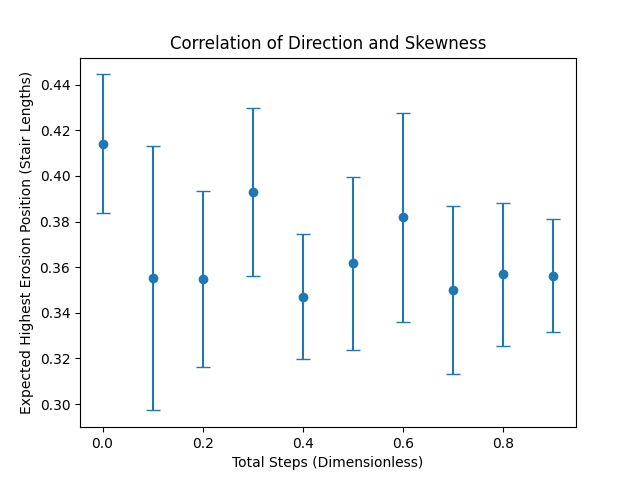

In [51]:
print(np.corrcoef([i for i in range(len(skews[1:]))], skews[1:]))

plt.figure()
plt.errorbar([i/num_points for i in range(num_points)], skews, yerr=stds, fmt='o', capsize=5,)
plt.xlabel('Total Steps (Dimensionless)')
plt.ylabel('Expected Highest Erosion Position (Stair Lengths)')
plt.title('Correlation of Direction and Skewness')
plt.show()

In [47]:
skews = []
stds = []

num_points = 10
samples_per_point = 10

for i in range(num_points):
    tmp = []
    for j in range(samples_per_point):
        stair_use = StairsUsage(200000, i/num_points, random.randint(1,5))
        model = SimulationSettings(random.randint(1000,3000), Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, sd.H_limestone_kPa, sd.sliding_distance, diff_ratio)), stairs_usage=stair_use, dt=1)
        er = 1-get_avg_side_func(model.final_shape[0])
        er = er/er.sum()
        tmp.append((er*[i for i in range(stair_length)]).mean())
    tmp = np.array(tmp)
    stds.append(tmp.std())
    skews.append(tmp.mean())

simulated 0/1000
simulated 1/1000
simulated 2/1000
simulated 3/1000
simulated 4/1000
simulated 5/1000
simulated 6/1000
simulated 7/1000
simulated 8/1000
simulated 9/1000
simulated 10/1000
simulated 11/1000
simulated 12/1000
simulated 13/1000
simulated 14/1000
simulated 15/1000
simulated 16/1000
simulated 17/1000
simulated 18/1000
simulated 19/1000
simulated 20/1000
simulated 21/1000
simulated 22/1000
simulated 23/1000
simulated 24/1000
simulated 25/1000
simulated 26/1000
simulated 27/1000
simulated 28/1000
simulated 29/1000
simulated 30/1000
simulated 31/1000
simulated 32/1000
simulated 33/1000
simulated 34/1000
simulated 35/1000
simulated 36/1000
simulated 37/1000
simulated 38/1000
simulated 39/1000
simulated 40/1000
simulated 41/1000
simulated 42/1000
simulated 43/1000
simulated 44/1000
simulated 45/1000
simulated 46/1000
simulated 47/1000
simulated 48/1000
simulated 49/1000
simulated 50/1000
simulated 51/1000
simulated 52/1000
simulated 53/1000
simulated 54/1000
simulated 55/1000
si

KeyboardInterrupt: 

[[ 1.        -0.9731608]
 [-0.9731608  1.       ]]


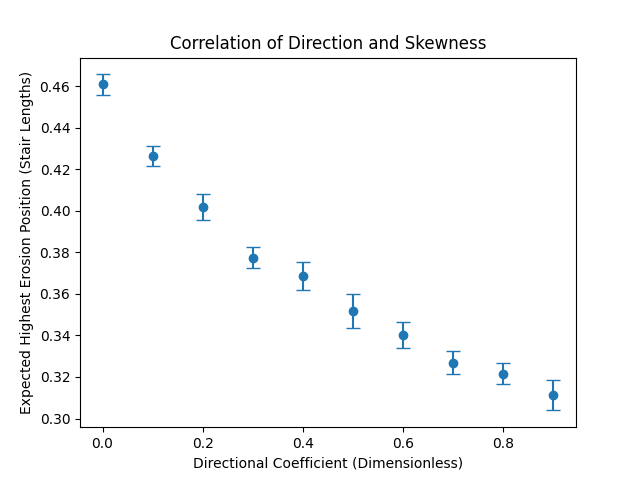

In [40]:
print(np.corrcoef([i for i in range(len(skews))], skews))

plt.figure()
plt.errorbar([i/num_points for i in range(num_points)], skews, yerr=stds, fmt='o', capsize=5,)
plt.xlabel('Directional Coefficient (Dimensionless)')
plt.ylabel('Expected Highest Erosion Position (Stair Lengths)')
plt.title('Correlation of Direction and Skewness')
plt.show()
    

simulated 0/1891
simulated 1/1891
simulated 2/1891
simulated 3/1891
simulated 4/1891
simulated 5/1891
simulated 6/1891
simulated 7/1891
simulated 8/1891
simulated 9/1891
simulated 10/1891
simulated 11/1891
simulated 12/1891
simulated 13/1891
simulated 14/1891
simulated 15/1891
simulated 16/1891
simulated 17/1891
simulated 18/1891
simulated 19/1891
simulated 20/1891
simulated 21/1891
simulated 22/1891
simulated 23/1891
simulated 24/1891
simulated 25/1891
simulated 26/1891
simulated 27/1891
simulated 28/1891
simulated 29/1891
simulated 30/1891
simulated 31/1891
simulated 32/1891
simulated 33/1891
simulated 34/1891
simulated 35/1891
simulated 36/1891
simulated 37/1891
simulated 38/1891
simulated 39/1891
simulated 40/1891
simulated 41/1891
simulated 42/1891
simulated 43/1891
simulated 44/1891
simulated 45/1891
simulated 46/1891
simulated 47/1891
simulated 48/1891
simulated 49/1891
simulated 50/1891
simulated 51/1891
simulated 52/1891
simulated 53/1891
simulated 54/1891
simulated 55/1891
si

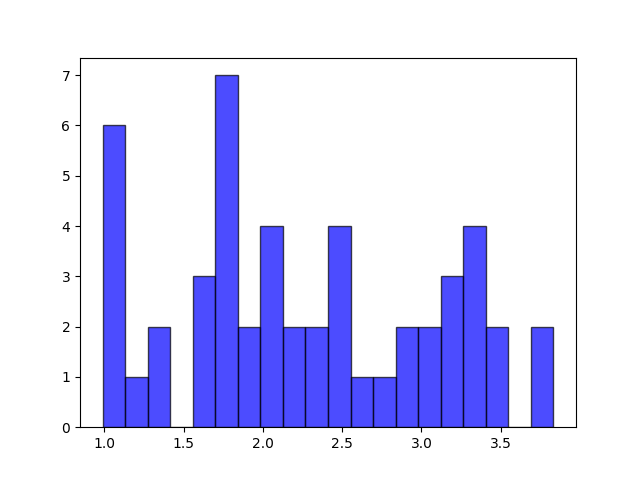

In [ ]:
tmp = []
for j in range(50):
    stair_use = StairsUsage(200000, i/num_points, False)
    model = SimulationSettings(random.randint(1000,2000), Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, sd.H_limestone_kPa, sd.sliding_distance, diff_ratio)), stairs_usage=stair_use, dt=1)
    er = 1-get_avg_side_func(model.final_shape[0])
    
    tmp.append((er*np.array([i for i in range(stair_length)])).mean())

print(i/num_points)
plt.figure()
plt.hist(tmp, bins=20, color='blue', edgecolor='black', alpha=0.7)
plt.show()

In [145]:
tmp

[array([8.3957011 , 8.28444496, 8.17622761, 8.06994747, 7.96487039,
        7.85903372, 7.74892882, 7.63014594, 7.49867258, 7.35238364,
        7.19198819, 7.02066672, 6.84241411, 6.66020201, 6.4752015 ,
        6.28728333, 6.09606435, 5.9017625 , 5.70552327, 5.50902526,
        5.31350118, 5.11894455, 4.92416785, 4.72734167, 4.52622267,
        4.31819731, 4.10098021, 3.8740135 , 3.6394121 , 3.40143212,
        3.16479274, 2.93314529, 2.70861018, 2.49224548, 2.28469851,
        2.08648471, 1.89789383, 1.71881386, 1.54867279, 1.38651637,
        1.23118046, 1.08151363, 0.93655365, 0.79556188, 0.65793326,
        0.52309265, 0.39045373, 0.25943065, 0.12945869, 0.        ]),
 array([8.16275533, 8.14054076, 8.11515302, 8.08336438, 8.04174987,
        7.98747321, 7.91873958, 7.83473655, 7.73540722, 7.62133772,
        7.49374286, 7.35434824, 7.2050318 , 7.04733989, 6.88220524,
        6.71003525, 6.53095636, 6.34495077, 6.1518931 , 5.95161883,
        5.74405501, 5.52937682, 5.30802521, 5.

8
[0.82362512 0.83421862 0.84433397 0.85367705 0.86218945 0.86975198
 0.87599737 0.88031034 0.88195537 0.88027593 0.8748871  0.86579183
 0.85339675 0.83834328 0.8211242  0.80179756 0.78019757 0.75648126
 0.73132747 0.70546361 0.6790511  0.65166608 0.62285682 0.59253506
 0.56078147 0.52751541 0.49259023 0.45616979 0.41885898 0.38146357
 0.34471264 0.30918858 0.27537956 0.24368459 0.21435379 0.1874621
 0.16296665 0.14078602 0.12082666 0.10296173 0.08701915 0.07280142
 0.06011553 0.04878862 0.03866397 0.02958596 0.02138466 0.0138671
 0.00681689 0.        ]
0.44741981399136593


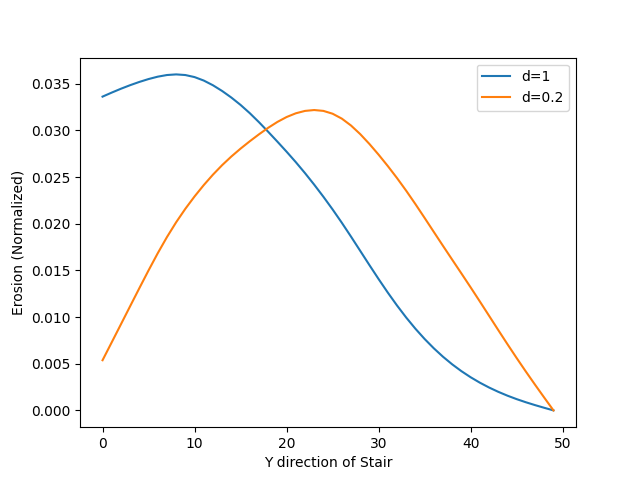

In [ ]:
stair_use = StairsUsage(200000, 0.9, False)
model = SimulationSettings(1000, Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, sd.H_limestone_kPa, sd.sliding_distance, diff_ratio)), stairs_usage=stair_use, dt=1)

plt.figure()
print(np.argmax(-1*get_avg_side_func(model.final_shape[0])+1))

er = 1-get_avg_side_func(model.final_shape[0])
er = er / er.sum()
print(er*np.array([i for i in range(stair_length)]).mean())

plt.plot(er, label='d=1')

stair_use = StairsUsage(200000, 0, True)
model = SimulationSettings(1000, Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, sd.H_limestone_kPa, sd.sliding_distance, diff_ratio)), stairs_usage=stair_use, dt=1)

er = 1-get_avg_side_func(model.final_shape[0])
er = er / er.sum()
plt.plot(er, label='d=0.2')
print((er*np.array([i for i in range(stair_length)])).mean())

plt.ylabel('Erosion (Normalized)')
plt.xlabel('Y direction of Stair')
plt.legend()
plt.show()


In [96]:
print(model.final_shape[0][:,stair_length].mean())

49.013183546814304


# Horizontal Direction
use this to determine peaks

In [123]:
xs = []
ys = []

for i in range(1,10,1):
    for j in range(10):
        stair_use = StairsUsage(random.randint(10000,50000), random.random(), i)
        model = SimulationSettings(random.randint(1000,2000), Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, sd.H_rubber_kPa, sd.sliding_distance*0.1, diff_ratio)), stairs_usage=stair_use, dt=1)
        ys.append(peak_index(get_avg_front_func(model.final_shape[0])))
        xs.append(i)
        

simulated 0/1113
simulated 1/1113
simulated 2/1113
simulated 3/1113
simulated 4/1113
simulated 5/1113
simulated 6/1113
simulated 7/1113
simulated 8/1113
simulated 9/1113
simulated 10/1113
simulated 11/1113
simulated 12/1113
simulated 13/1113
simulated 14/1113
simulated 15/1113
simulated 16/1113
simulated 17/1113
simulated 18/1113
simulated 19/1113
simulated 20/1113
simulated 21/1113
simulated 22/1113
simulated 23/1113
simulated 24/1113
simulated 25/1113
simulated 26/1113
simulated 27/1113
simulated 28/1113
simulated 29/1113
simulated 30/1113
simulated 31/1113
simulated 32/1113
simulated 33/1113
simulated 34/1113
simulated 35/1113
simulated 36/1113
simulated 37/1113
simulated 38/1113
simulated 39/1113
simulated 40/1113
simulated 41/1113
simulated 42/1113
simulated 43/1113
simulated 44/1113
simulated 45/1113
simulated 46/1113
simulated 47/1113
simulated 48/1113
simulated 49/1113
simulated 50/1113
simulated 51/1113
simulated 52/1113
simulated 53/1113
simulated 54/1113
simulated 55/1113
si

[[1.         0.87518516]
 [0.87518516 1.        ]]


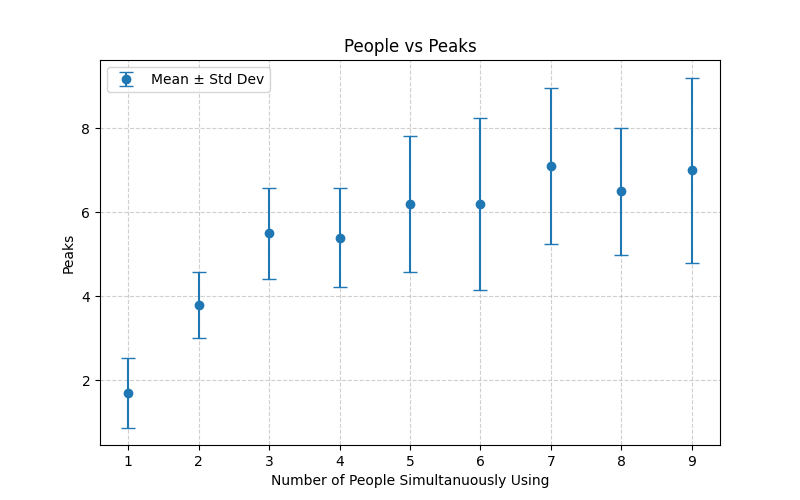

In [126]:

data = pd.DataFrame({'x': xs, 'y': ys})

# Group by 'x' and calculate mean and standard deviation of 'y'
result = data.groupby('x')['y'].agg(['mean', 'std']).reset_index()

# Extract values for plotting
x_values = result['x']
y_means = result['mean']
y_stds = result['std']

# Plotting
plt.figure(figsize=(8, 5))
plt.errorbar(x_values, y_means, yerr=y_stds, fmt='o', capsize=5, label='Mean ± Std Dev')
plt.title('People vs Peaks')
plt.xlabel('Number of People Simultanuously Using')
plt.ylabel('Peaks')
plt.grid(True, linestyle='--', alpha=0.6)
print(np.corrcoef(x_values, y_means))
plt.legend()
plt.show()

(3, 200, 150)


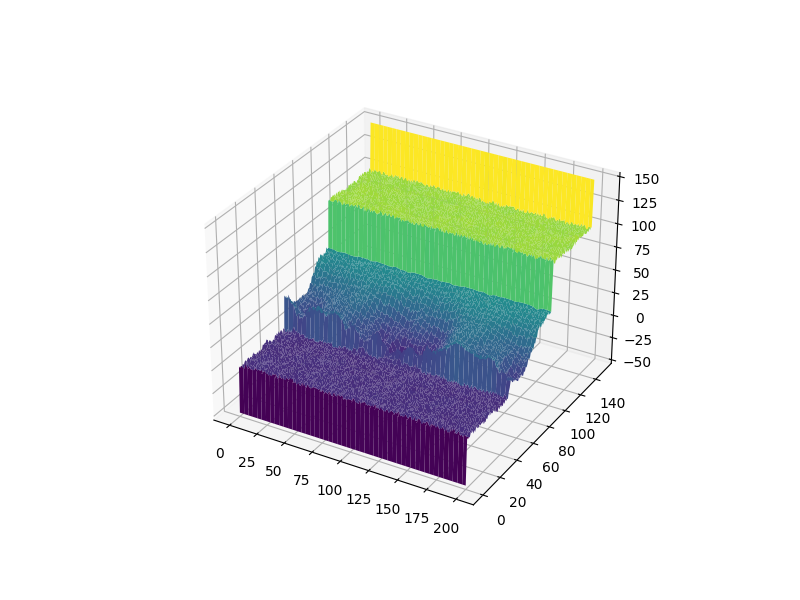

In [14]:
# i=5000
# stair_use = StairsUsage(200000, 0.7, 5)
# model = SimulationSettings(5000, Environment(), Stairs(stair_width, stair_length, stair_height, Material(sd.k_dry, sd.H_limestone_kPa, sd.sliding_distance, diff_ratio)), stairs_usage=stair_use, dt=0.5)


fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
print(model.final_shape.shape)
# Plot the initial surface
surface = ax.plot_surface(model.final_shape[1], model.final_shape[2], model.final_shape[0], cmap='viridis', edgecolor='none')


0.047618502805322475


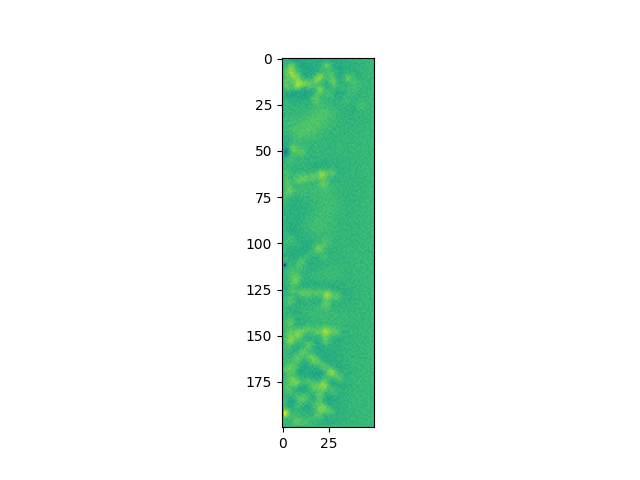

In [34]:
plt.figure()

plt.imshow(laplacian(model.final_shape[0][:,stair_length:stair_length*2], 1, 1))

print(laplacian(model.final_shape[0][:,stair_length:stair_length*2],1,1).std())


                              

inner edge 

Y expected errosion 

peaks in X dir

|       |Tot S|  N  | Dir |
|-------|-----|-----|-----|
| inner |-0.18| 0.31| 0.34|
| sides |-0.12| 0.25| 0.97|
| front | 0.2 | 0.87| 0.2 |
| rough | 0.38| 0.1 | 0.2 |



